In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install shap

In [ ]:
!pip install tensorflow
!pip install keras

In [ ]:
import numpy as np
import pandas as pd
import shap
from sklearn.metrics import classification_report
from scipy import signal
import keras 
from tensorflow.keras.models import Sequential 
from keras.utils import to_categorical
from keras.layers import Activation, Dense
from sklearn.model_selection import train_test_split
import tensorflow.compat.v1.keras.backend as K
import tensorflow as tf
tf.compat.v1.disable_eager_execution()
tf.compat.v1.disable_v2_behavior()

Instructions for updating:
non-resource variables are not supported in the long term


In [ ]:
#/content/drive/MyDrive/Innopolis Phd/lab_computer/phd file/Data sets/Participant 1/Cubes for spectra/Backgr_int_0.1_type_0.4.dat
# /content/drive/MyDrive/Innopolis Phd/linux/dataset/Participant 1/Figs for spectra/Backgr_int_0.1.dat
 # not found /content/drive/MyDrive/Innopolis Phd/lab_computer/phd file/Data sets/Participant 1/Figs for spectra/Backgr_int_0.1_type_0.4

class EEG:
    def __init__(self, participant):
        self.int = {}
        self.delta = {}
        self.theta = {}
        self.alpha = {}
        self.beta = {}
        self.gamma = {}
    #    base= "/content/drive/MyDrive/Innopolis Phd/lab_computer/phd file/Data sets/"
        for I in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]:
            self.int[I] = np.loadtxt('/content/drive/MyDrive/Innopolis Phd/lab_computer/phd file/Data sets/Participant '+str(participant)+'/Figs for spectra/Backgr_int_'+str(I)+'.dat')
            delta_signal = np.empty(self.int[I].shape)
            theta_signal =  np.empty(self.int[I].shape)
            alpha_signal = np.empty(self.int[I].shape)
            beta_signal = np.empty(self.int[I].shape)
            gamma_signal = np.empty(self.int[I].shape)
            for c in range(self.int[I].shape[1]):
                delta_signal[:,c], theta_signal[:,c],alpha_signal[:, c], beta_signal[:, c],gamma_signal[:,c] = self.fir_filtering(I, c)
            self.delta[I] = delta_signal
            self.theta[I] = theta_signal
            self.alpha[I] = alpha_signal
            self.beta[I] = beta_signal 
            self.gamma[I] = gamma_signal
    def fir_filtering(self, I, c):
        filter_delta = signal.firwin(400, [1.0, 4.0], pass_zero=False, fs=250)
        filter_theta = signal.firwin(400, [5.0, 8.0], pass_zero=False, fs=250)
        filter_alpha = signal.firwin(400, [8.0, 12.0], pass_zero=False, fs=250)
        filter_beta = signal.firwin(400, [13.0, 30.0], pass_zero=False, fs=250)
        filter_gamma = signal.firwin(400, [31.0, 45.0], pass_zero=False, fs=250)
        res_delta = signal.convolve(self.int[I][:, c], filter_delta, mode='same')
        res_theta = signal.convolve(self.int[I][:, c], filter_theta, mode='same')
        res_alpha = signal.convolve(self.int[I][:, c], filter_alpha, mode='same')
        res_beta = signal.convolve(self.int[I][:, c], filter_beta, mode='same')
        res_gamma = signal.convolve(self.int[I][:, c], filter_gamma, mode='same')
        return res_delta,res_theta, res_alpha,res_beta,res_gamma 

In [ ]:
Intencity = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]

def createdataframe(signal_fiq,user):
    global Intencity
    tem_signal = []
    print(signal_fiq)
    eeg_person = EEG(user)
    for i in Intencity:
        for ch in range(0,31):
            S = 'tem_signal.append(np.append(eeg_person.'+signal_fiq+'.get(i)[:,ch][0:15000],i))' 
            eval(S)
      #  tem_signal.append(np.append(eeg_person.A.get(i)[:,ch][0:15000],i))

    return pd.DataFrame(tem_signal) 


In [ ]:
def shap_explaner(model,X_test):
  shap.initjs()
  e = shap.DeepExplainer(model, X_test)
  shap_values = e.shap_values(X_test[1:5])
  return shap.summary_plot(shap_values,X_test)

In [ ]:
def createmodel(df):
  df_new = df.copy()
  y = df_new.iloc[:,-1] *10 
  X = df_new.iloc[:, :-1]
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
  y_test_original = y_test
  X_train = X_train.to_numpy()
  X_test = X_test.to_numpy()
  y_train = to_categorical(y_train.astype(int).to_numpy())
  y_test = to_categorical(y_test.astype(int).to_numpy())
  keras.backend.clear_session()
  model = Sequential()
  model.add(Dense(2500, input_shape= (X_train.shape[1],) ,activation='tanh'))
  model.add(Dense(1000, activation='tanh'))
  model.add(Dense(500, activation='tanh'))
  model.add(Dense(200, activation='tanh'))
  model.add(Dense(100, activation='tanh'))
  model.add(Dense(50, activation='tanh'))
  model.add(Dense(25, activation='tanh'))
  model.add(Dense(15, activation='tanh'))
  model.add(Dense(11, activation='softmax'))
  model.compile(optimizer='rmsprop',
             loss='categorical_crossentropy',
             metrics=['accuracy'])
  model.summary()
  model.fit(X_train,y_train, epochs=20, batch_size=10,verbose=2)
  y_pred = model.predict_classes(X_test).tolist()
  shap_explaner(model,X_test)
  return classification_report(y_test_original, y_pred) 

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


keras is no longer supported, please use tf.keras instead.
Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


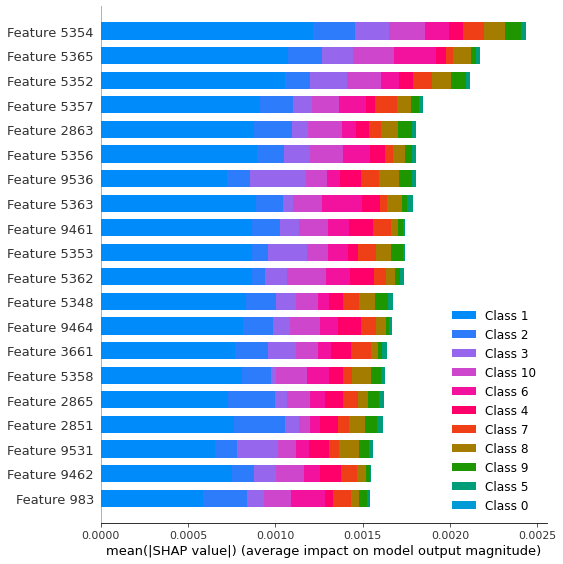

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62
weighted avg       1.00      1.00      1.00        62



In [ ]:
df_delta= createdataframe("delta",1)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


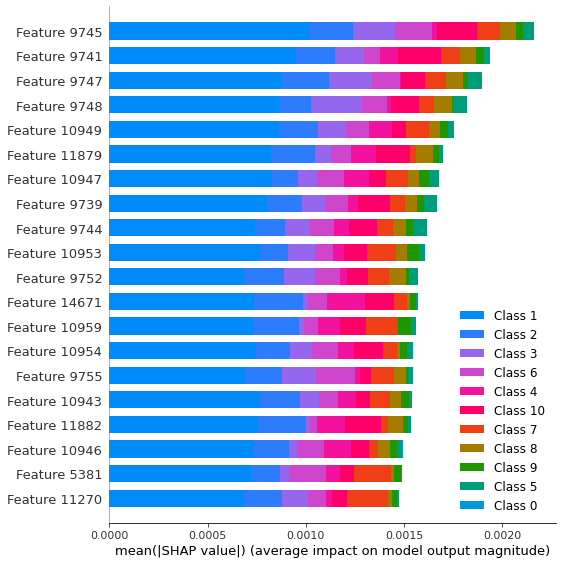

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62
weighted avg       1.00      1.00      1.00        62



In [ ]:
df_delta= createdataframe("delta",2)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


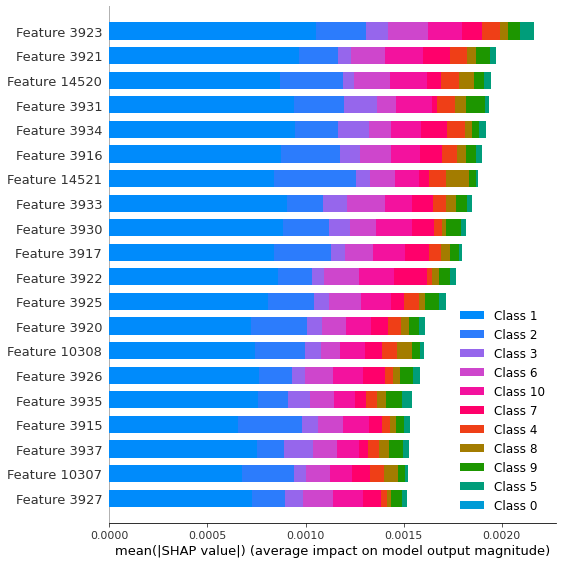

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62
weighted avg       1.00      1.00      1.00        62



In [ ]:
df_delta= createdataframe("delta",3)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


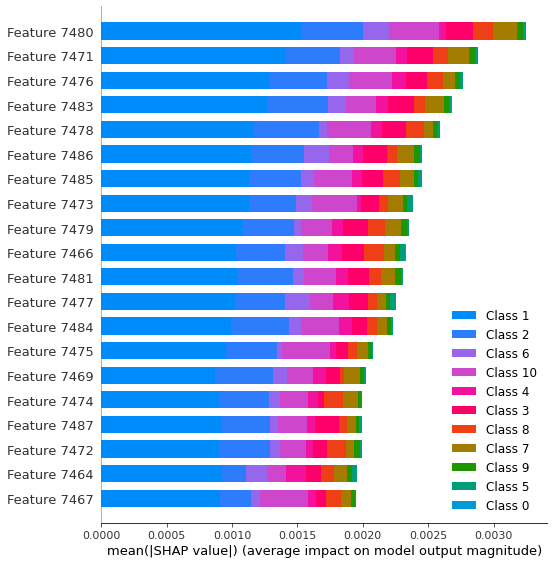

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       0.90      1.00      0.95         9
         7.0       1.00      0.83      0.91         6
         8.0       0.86      1.00      0.92         6
         9.0       1.00      0.67      0.80         3
        10.0       1.00      1.00      1.00         8

    accuracy                           0.97        62
   macro avg       0.98      0.95      0.96        62
weighted avg       0.97      0.97      0.97        62



In [ ]:
df_delta= createdataframe("delta",4)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


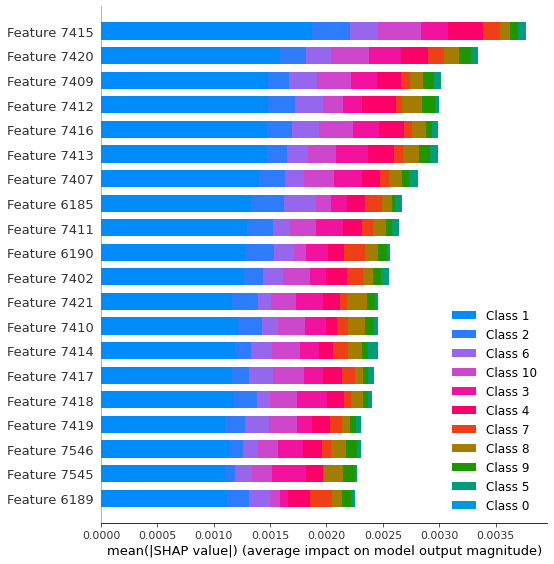

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62
weighted avg       1.00      1.00      1.00        62



In [ ]:
df_delta= createdataframe("delta",5)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


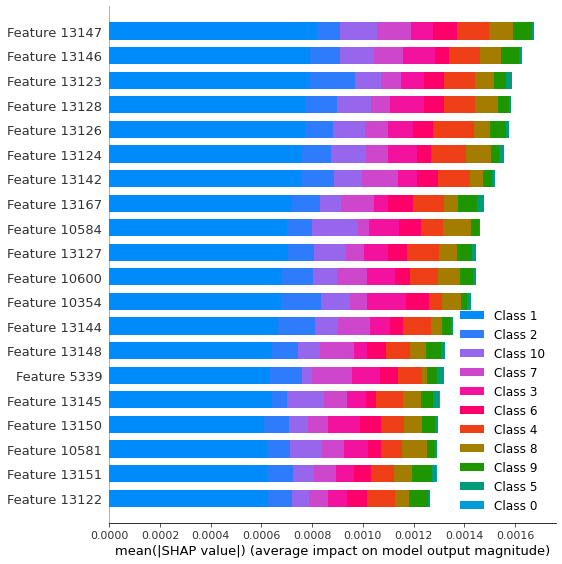

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62
weighted avg       1.00      1.00      1.00        62



In [ ]:
df_theta= createdataframe("theta",1)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


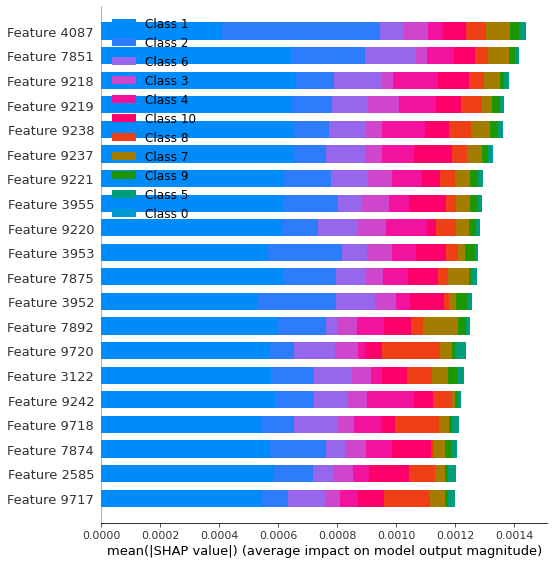

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62
weighted avg       1.00      1.00      1.00        62



In [ ]:
df_theta= createdataframe("theta",2)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


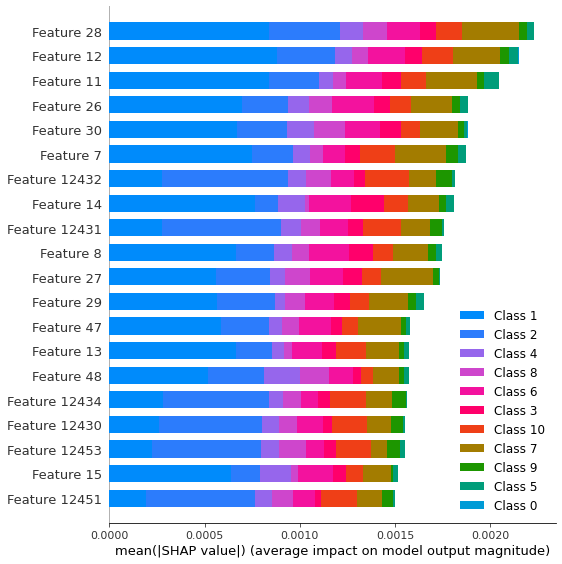

              precision    recall  f1-score   support

         1.0       0.88      1.00      0.93         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      0.88      0.93         8

    accuracy                           0.98        62
   macro avg       0.99      0.99      0.99        62
weighted avg       0.99      0.98      0.98        62



In [ ]:
df_theta= createdataframe("theta",3)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


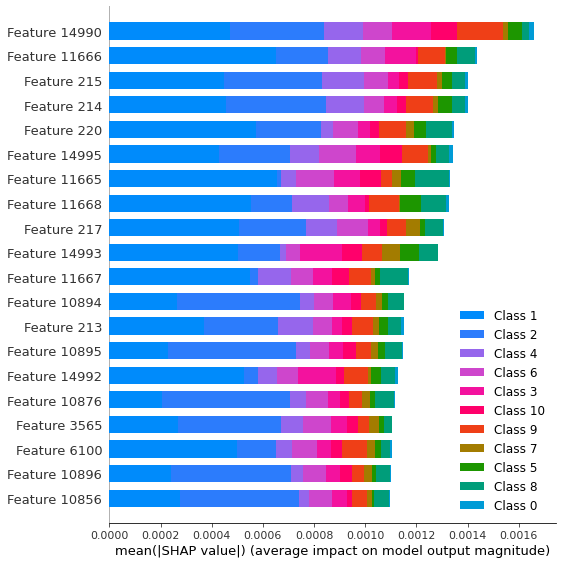

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       0.67      1.00      0.80         2
         6.0       0.90      1.00      0.95         9
         7.0       1.00      0.83      0.91         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      0.88      0.93         8

    accuracy                           0.97        62
   macro avg       0.96      0.97      0.96        62
weighted avg       0.97      0.97      0.97        62



In [ ]:
df_theta= createdataframe("theta",4)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


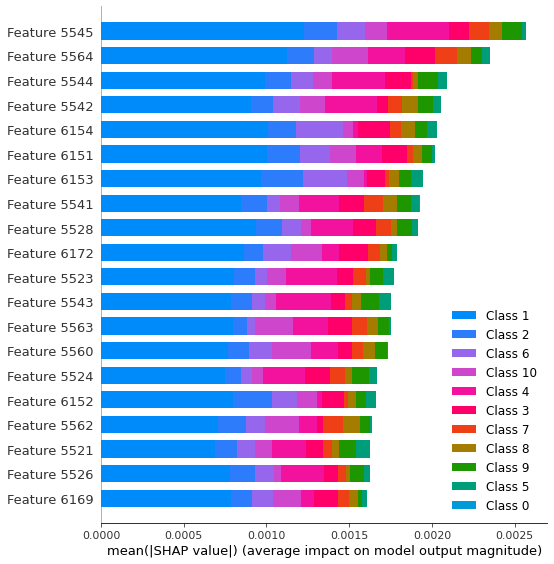

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62
weighted avg       1.00      1.00      1.00        62



In [ ]:
df_theta= createdataframe("theta",5)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


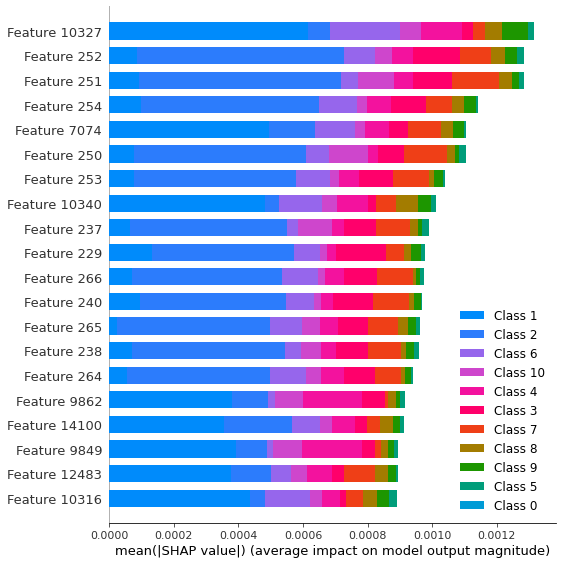

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62
weighted avg       1.00      1.00      1.00        62



In [ ]:
df_alpha= createdataframe("alpha",1)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


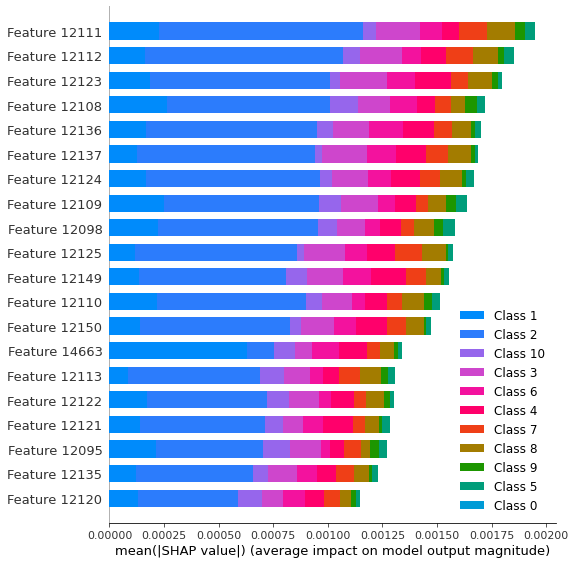

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62
weighted avg       1.00      1.00      1.00        62



In [ ]:
df_alpha= createdataframe("alpha",2)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


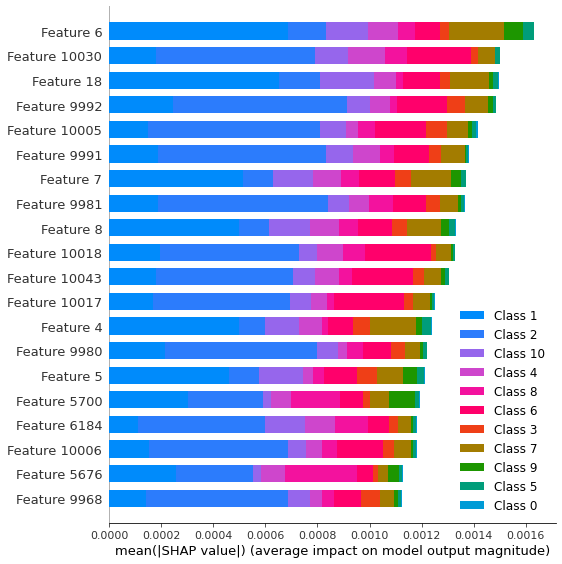

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      0.83      0.91         6
         8.0       0.86      1.00      0.92         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           0.98        62
   macro avg       0.99      0.98      0.98        62
weighted avg       0.99      0.98      0.98        62



In [ ]:
df_alpha= createdataframe("alpha",3)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


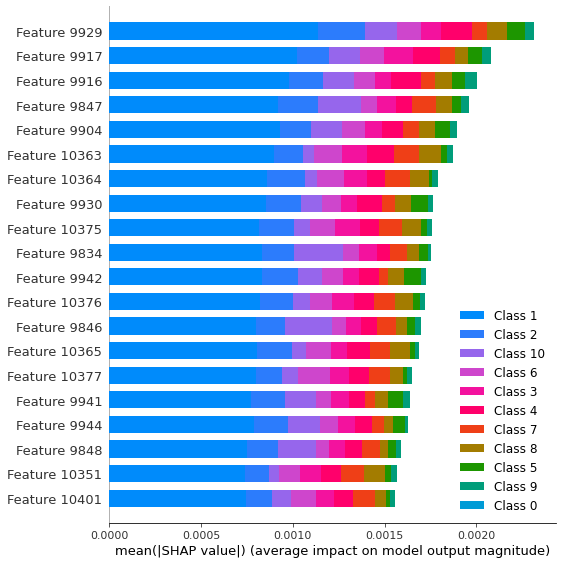

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      0.86      0.92         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       0.89      1.00      0.94         8

    accuracy                           0.98        62
   macro avg       0.99      0.99      0.99        62
weighted avg       0.99      0.98      0.98        62



In [ ]:
df_alpha= createdataframe("alpha",4)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


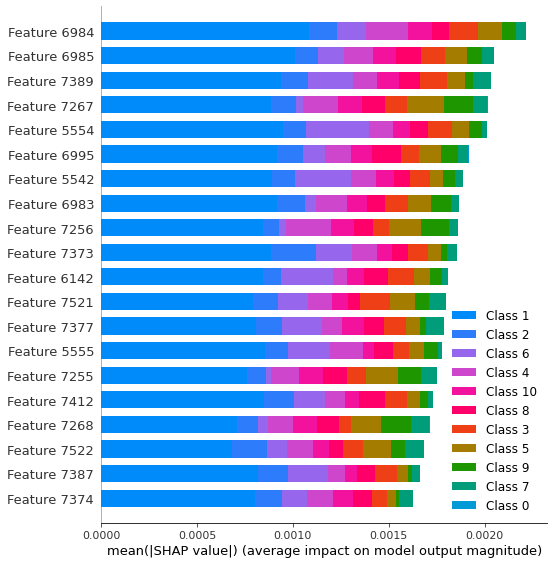

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      0.88      0.93         8
         4.0       1.00      1.00      1.00         7
         5.0       0.50      1.00      0.67         2
         6.0       0.82      1.00      0.90         9
         7.0       1.00      0.67      0.80         6
         8.0       1.00      1.00      1.00         6
         9.0       0.67      0.67      0.67         3
        10.0       1.00      0.88      0.93         8

    accuracy                           0.92        62
   macro avg       0.90      0.91      0.89        62
weighted avg       0.94      0.92      0.92        62



In [ ]:
df_alpha= createdataframe("alpha",5)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


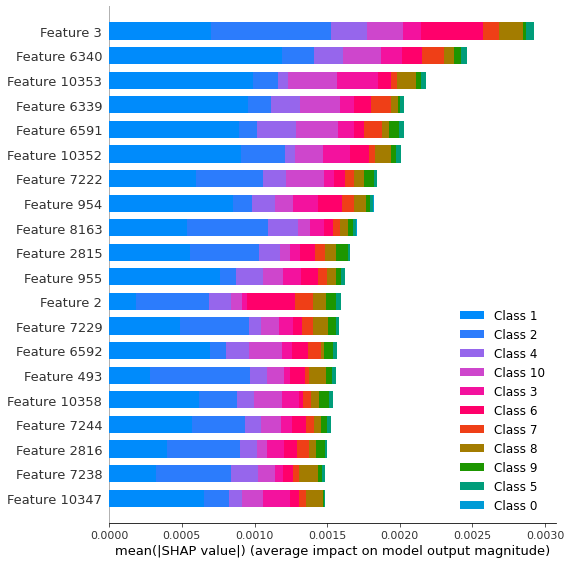

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       0.88      1.00      0.93         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      0.89      0.94         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           0.98        62
   macro avg       0.99      0.99      0.99        62
weighted avg       0.99      0.98      0.98        62



In [ ]:
df_beta= createdataframe("beta",1)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


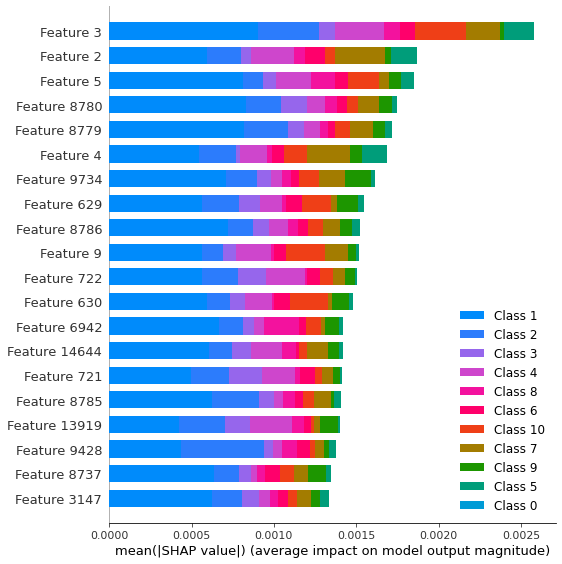

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      1.00      1.00         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      1.00      1.00         6
         8.0       1.00      1.00      1.00         6
         9.0       0.75      1.00      0.86         3
        10.0       1.00      0.88      0.93         8

    accuracy                           0.98        62
   macro avg       0.97      0.99      0.98        62
weighted avg       0.99      0.98      0.98        62



In [ ]:
df_beta= createdataframe("beta",2)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


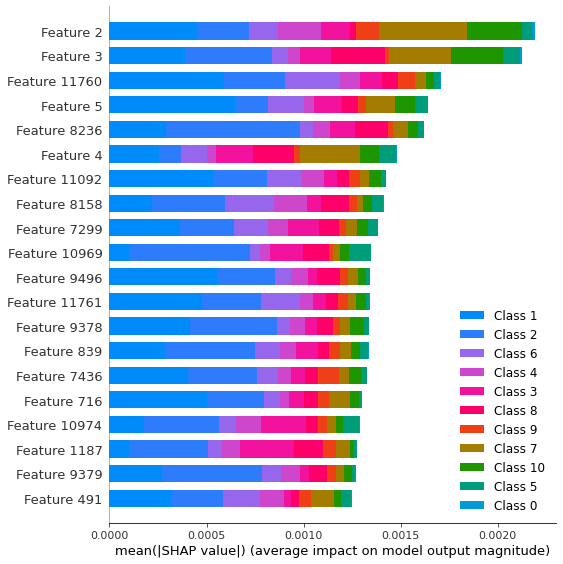

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       0.86      1.00      0.92         6
         3.0       1.00      1.00      1.00         8
         4.0       0.86      0.86      0.86         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      0.67      0.80         6
         8.0       0.86      1.00      0.92         6
         9.0       0.75      1.00      0.86         3
        10.0       1.00      0.88      0.93         8

    accuracy                           0.94        62
   macro avg       0.93      0.94      0.93        62
weighted avg       0.94      0.94      0.93        62



In [ ]:
df_beta= createdataframe("beta",3)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


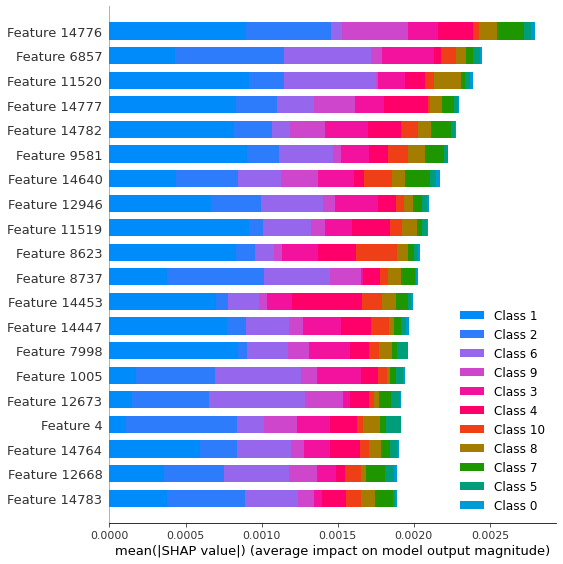

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       0.89      1.00      0.94         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       0.75      1.00      0.86         9
         7.0       1.00      0.67      0.80         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      0.75      0.86         8

    accuracy                           0.94        62
   macro avg       0.96      0.94      0.95        62
weighted avg       0.95      0.94      0.93        62



In [ ]:
df_beta= createdataframe("beta",4)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


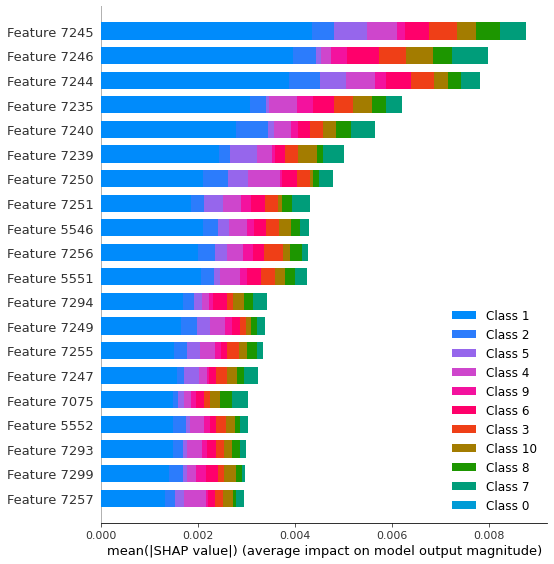

              precision    recall  f1-score   support

         1.0       0.88      1.00      0.93         7
         2.0       1.00      0.83      0.91         6
         3.0       1.00      0.88      0.93         8
         4.0       0.88      1.00      0.93         7
         5.0       0.33      0.50      0.40         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      0.83      0.91         6
         8.0       1.00      1.00      1.00         6
         9.0       0.75      1.00      0.86         3
        10.0       1.00      0.88      0.93         8

    accuracy                           0.92        62
   macro avg       0.88      0.89      0.88        62
weighted avg       0.94      0.92      0.92        62



In [ ]:
df_beta= createdataframe("beta",5)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


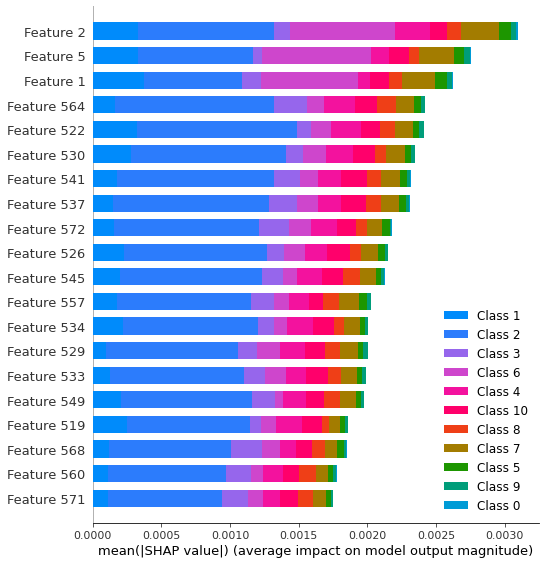

              precision    recall  f1-score   support

         1.0       0.88      1.00      0.93         7
         2.0       1.00      1.00      1.00         6
         3.0       0.89      1.00      0.94         8
         4.0       1.00      1.00      1.00         7
         5.0       1.00      1.00      1.00         2
         6.0       1.00      1.00      1.00         9
         7.0       1.00      0.83      0.91         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      0.67      0.80         3
        10.0       1.00      1.00      1.00         8

    accuracy                           0.97        62
   macro avg       0.98      0.95      0.96        62
weighted avg       0.97      0.97      0.97        62



In [ ]:
df_gamma= createdataframe("gamma",1)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


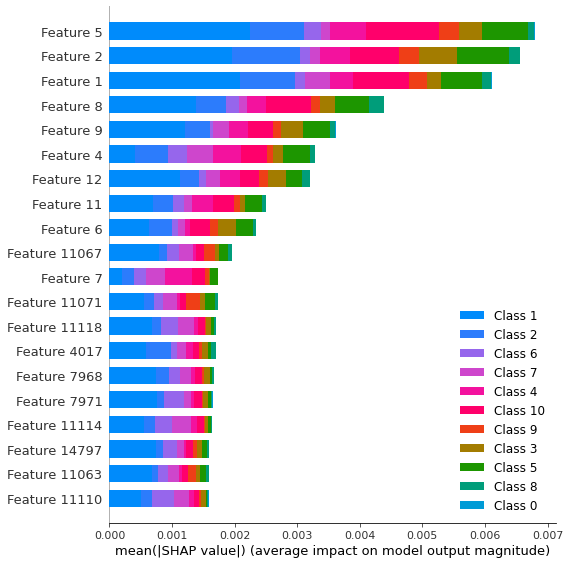

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      0.88      0.93         8
         4.0       1.00      1.00      1.00         7
         5.0       0.67      1.00      0.80         2
         6.0       1.00      1.00      1.00         9
         7.0       0.75      1.00      0.86         6
         8.0       1.00      0.67      0.80         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      1.00      1.00         8

    accuracy                           0.95        62
   macro avg       0.94      0.95      0.94        62
weighted avg       0.97      0.95      0.95        62



In [ ]:
df_gamma= createdataframe("gamma",2)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


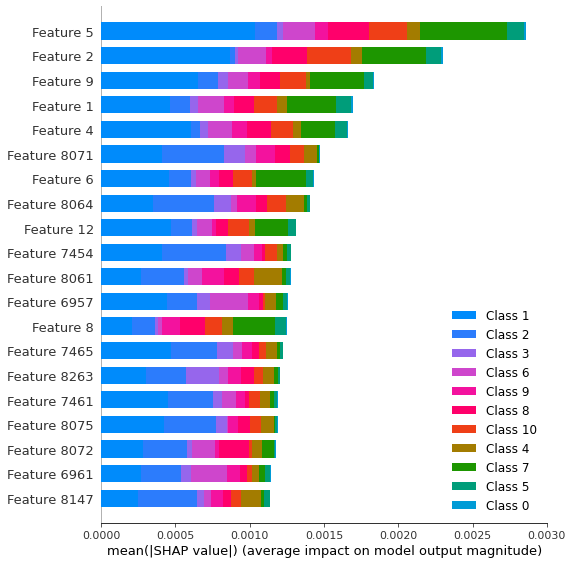

              precision    recall  f1-score   support

         1.0       0.70      1.00      0.82         7
         2.0       1.00      0.83      0.91         6
         3.0       0.80      1.00      0.89         8
         4.0       1.00      0.71      0.83         7
         5.0       1.00      1.00      1.00         2
         6.0       0.90      1.00      0.95         9
         7.0       1.00      0.67      0.80         6
         8.0       1.00      1.00      1.00         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      0.88      0.93         8

    accuracy                           0.90        62
   macro avg       0.94      0.91      0.91        62
weighted avg       0.93      0.90      0.90        62



In [ ]:
df_gamma= createdataframe("gamma",3)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


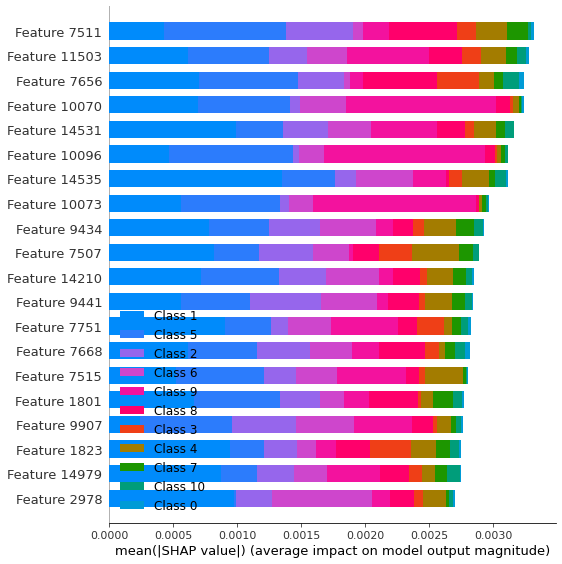

              precision    recall  f1-score   support

         1.0       0.88      1.00      0.93         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      0.88      0.93         8
         4.0       1.00      1.00      1.00         7
         5.0       0.67      1.00      0.80         2
         6.0       0.75      1.00      0.86         9
         7.0       1.00      0.50      0.67         6
         8.0       0.71      0.83      0.77         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      0.75      0.86         8

    accuracy                           0.89        62
   macro avg       0.90      0.90      0.88        62
weighted avg       0.91      0.89      0.88        62



In [ ]:
df_gamma= createdataframe("gamma",4)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


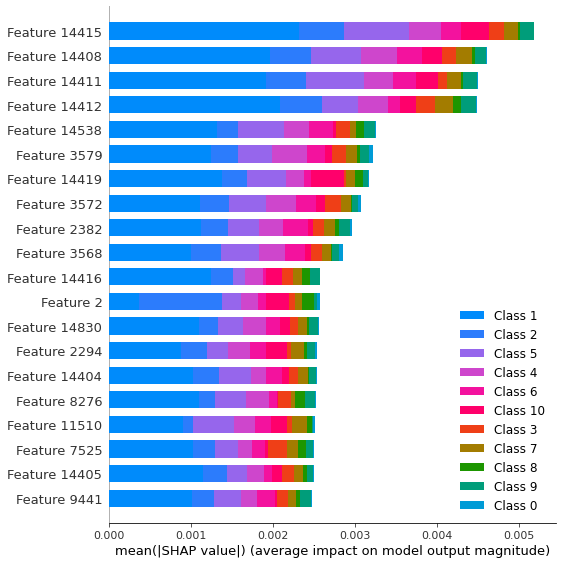

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         7
         2.0       1.00      1.00      1.00         6
         3.0       1.00      0.88      0.93         8
         4.0       0.88      1.00      0.93         7
         5.0       0.40      1.00      0.57         2
         6.0       0.90      1.00      0.95         9
         7.0       1.00      0.67      0.80         6
         8.0       1.00      0.83      0.91         6
         9.0       1.00      1.00      1.00         3
        10.0       1.00      0.88      0.93         8

    accuracy                           0.92        62
   macro avg       0.92      0.93      0.90        62
weighted avg       0.95      0.92      0.93        62



In [ ]:
df_gamma= createdataframe("gamma",5)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

In [ ]:

def createdataframeleft(signal_fiq,user):
    global Intencity
    tem_signal = []
    print(signal_fiq)
    eeg_person = EEG(user)
    for i in Intencity:
        for ch in range(0,31,2):
            S = 'tem_signal.append(np.append(eeg_person.'+signal_fiq+'.get(i)[:,ch][0:15000],i))' 
            eval(S)
      #  tem_signal.append(np.append(eeg_person.A.get(i)[:,ch][0:15000],i))

    return pd.DataFrame(tem_signal) 

In [ ]:
def createdataframeright(signal_fiq,user):
    global Intencity
    tem_signal = []
    print(signal_fiq)
    eeg_person = EEG(user)
    for i in Intencity:
        for ch in range(1,31,2):
            S = 'tem_signal.append(np.append(eeg_person.'+signal_fiq+'.get(i)[:,ch][0:15000],i))' 
            eval(S)
      #  tem_signal.append(np.append(eeg_person.A.get(i)[:,ch][0:15000],i))

    return pd.DataFrame(tem_signal)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


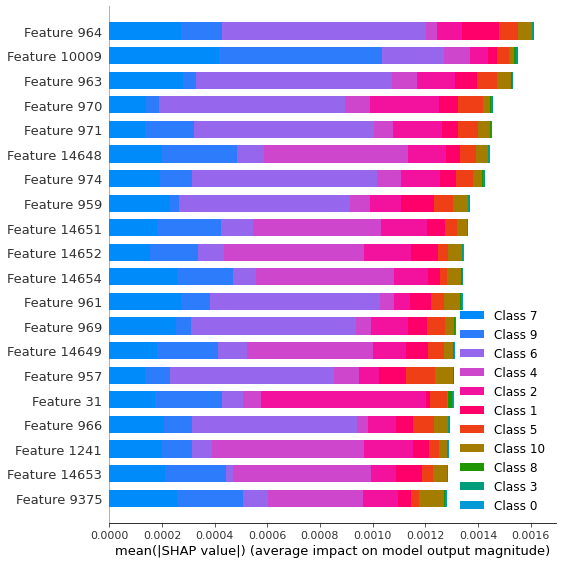

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_delta= createdataframeleft("delta",1)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


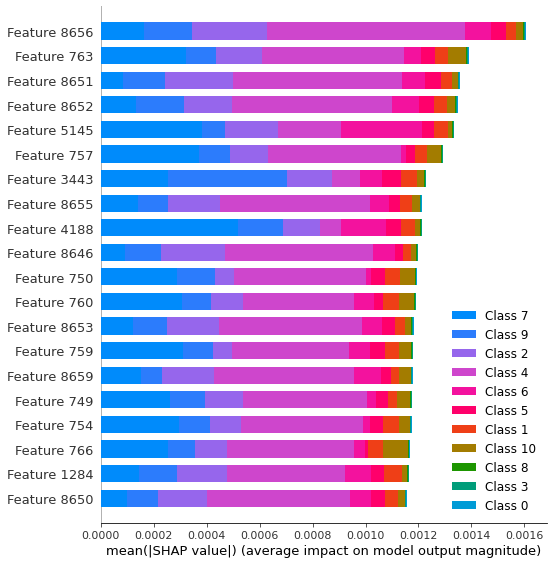

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_delta= createdataframeleft("delta",2)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


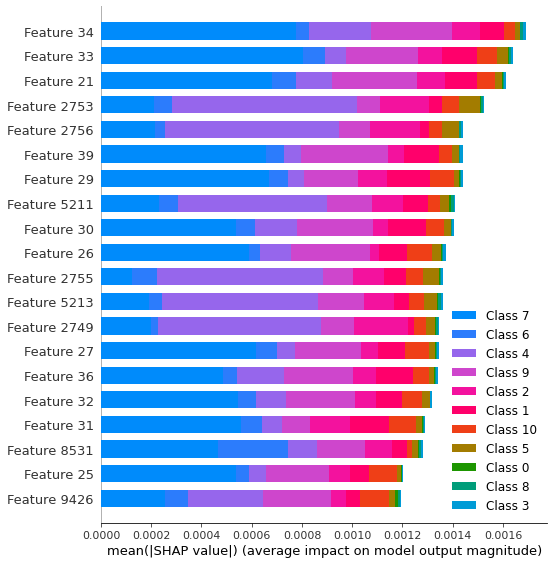

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_delta= createdataframeleft("delta",3)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


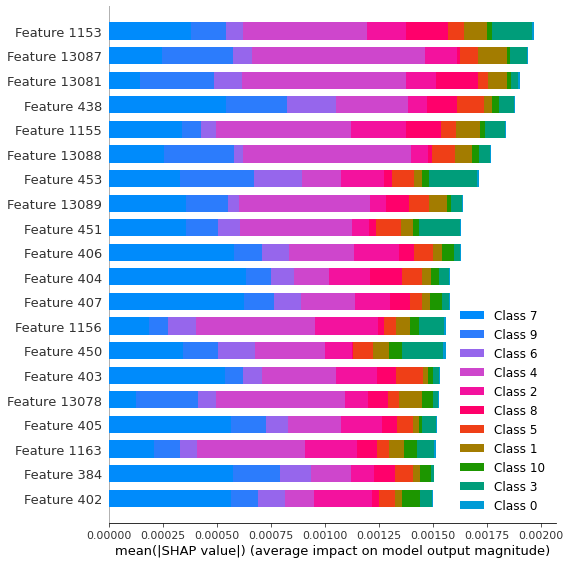

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_delta= createdataframeleft("delta",4)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


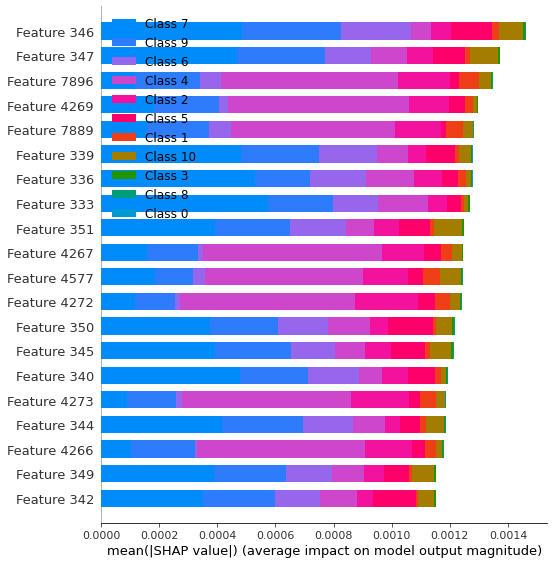

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_delta= createdataframeleft("delta",5)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


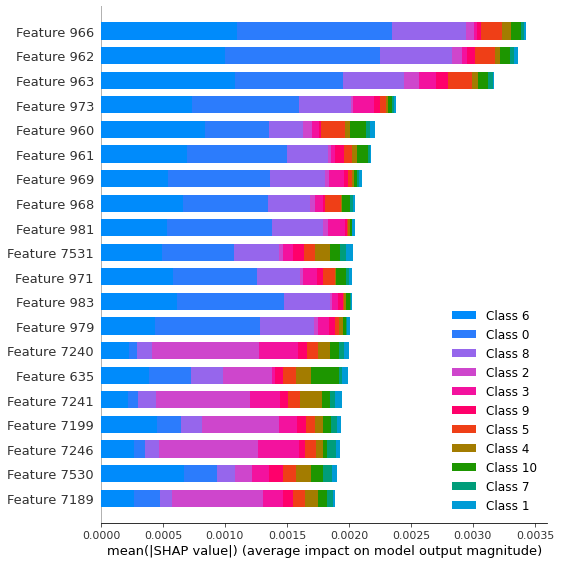

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_delta= createdataframeright("delta",1)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


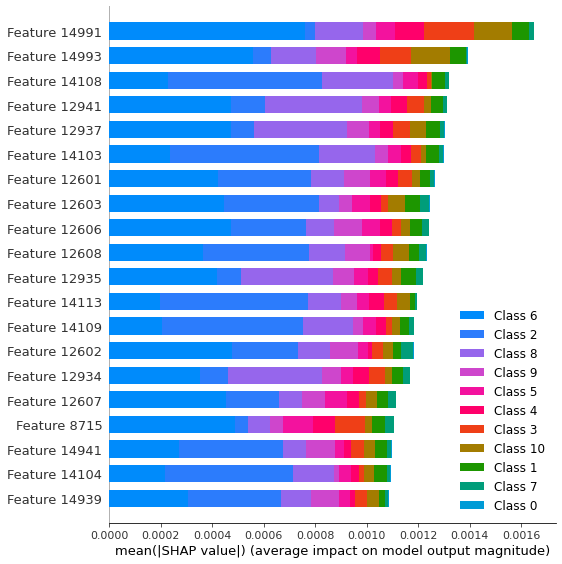

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_delta= createdataframeright("delta",2)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


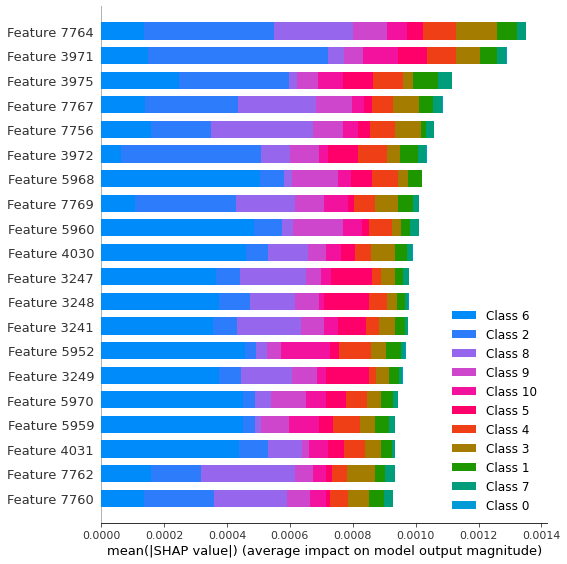

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_delta= createdataframeright("delta",3)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


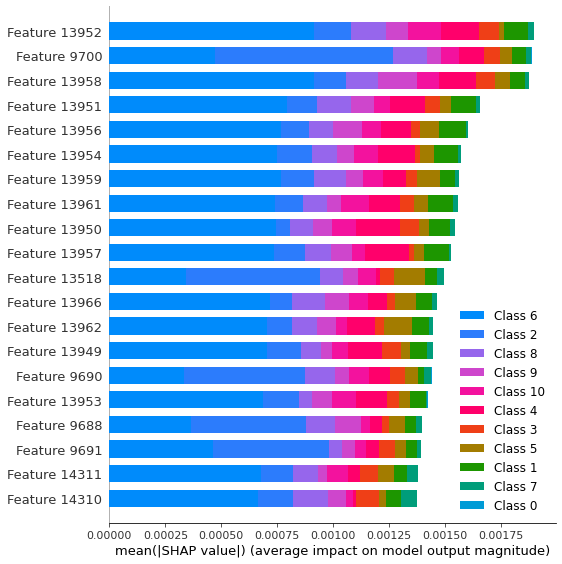

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_delta= createdataframeright("delta",4)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


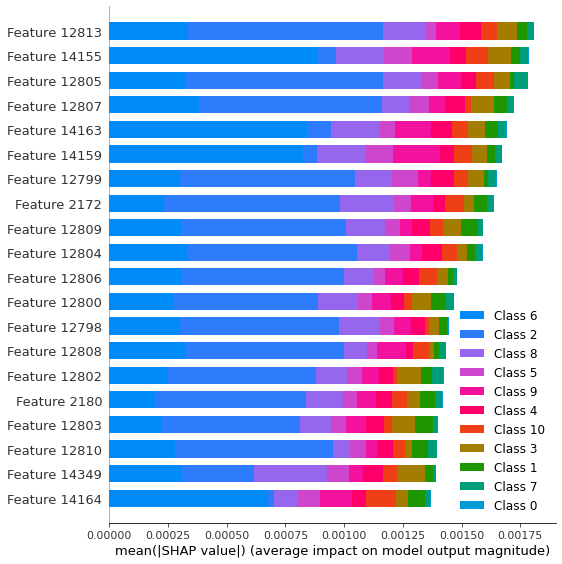

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_delta= createdataframeright("delta",5)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


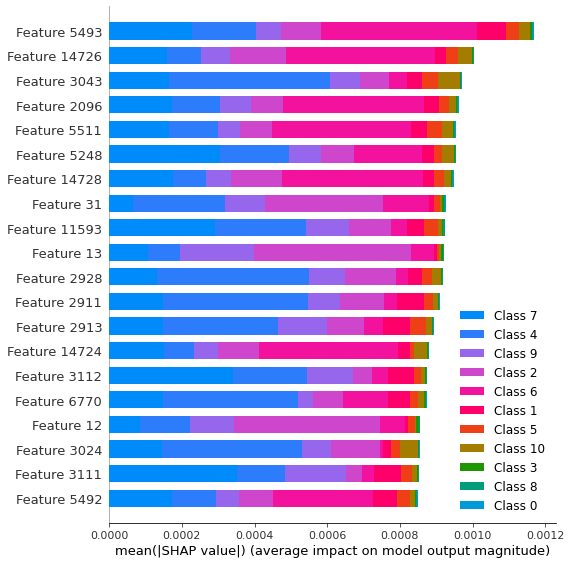

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_theta= createdataframeleft("theta",1)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


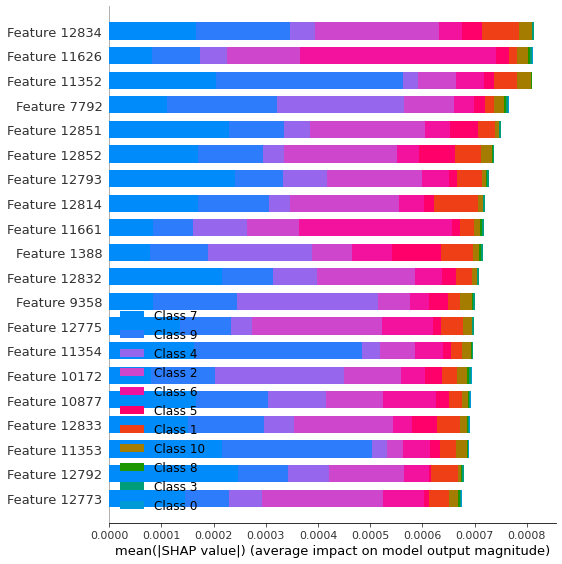

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_theta= createdataframeleft("theta",2)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


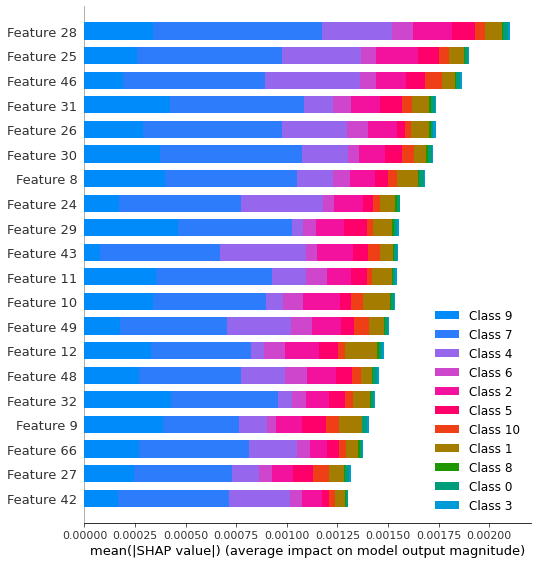

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       0.75      1.00      0.86         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      0.86      0.92         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           0.97        32
   macro avg       0.97      0.98      0.97        32
weighted avg       0.98      0.97      0.97        32



In [ ]:
df_theta= createdataframeleft("theta",3)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


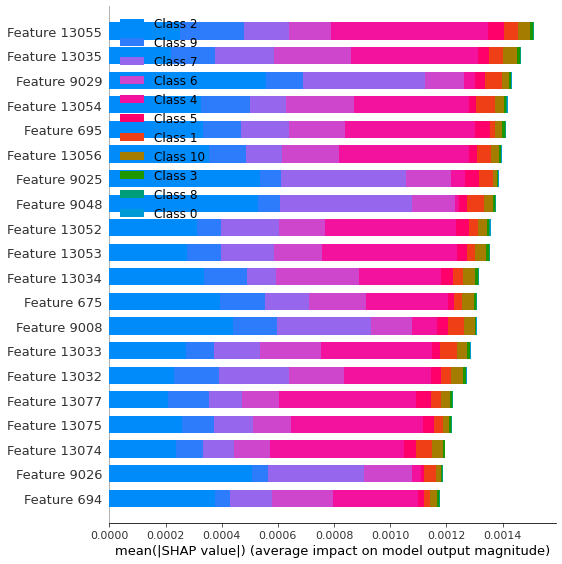

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_theta= createdataframeleft("theta",4)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


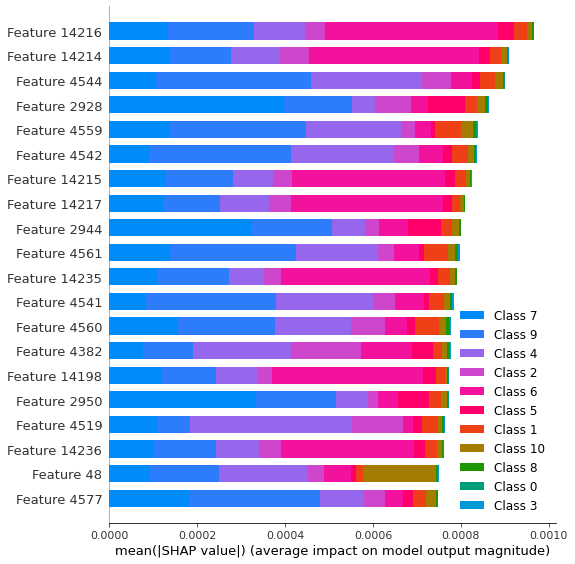

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_theta= createdataframeleft("theta",5)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


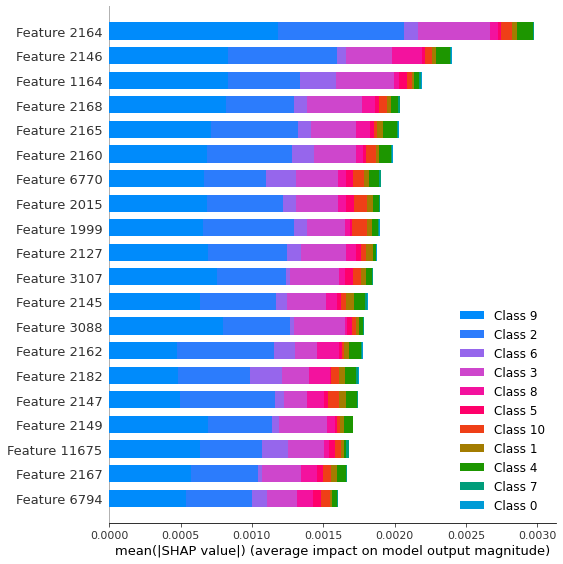

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_theta= createdataframeright("theta",1)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


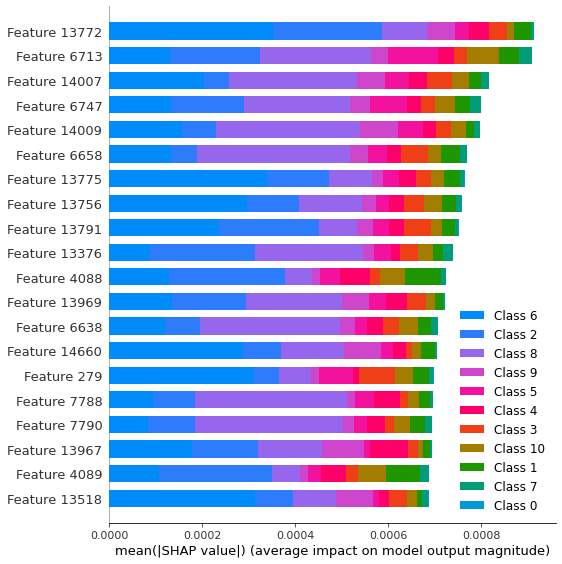

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_theta= createdataframeright("theta",2)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


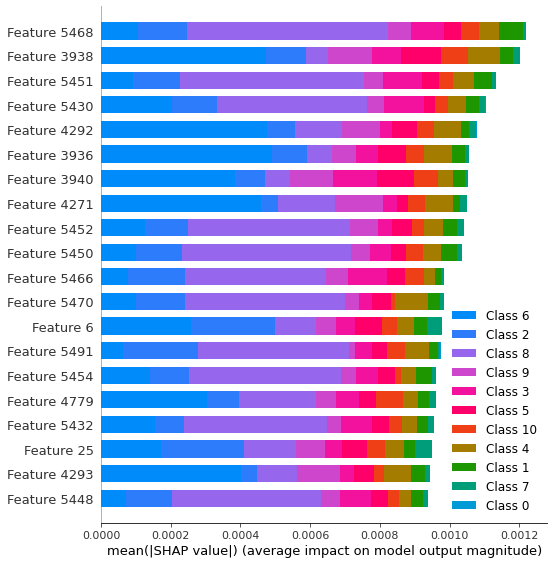

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_theta= createdataframeright("theta",3)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


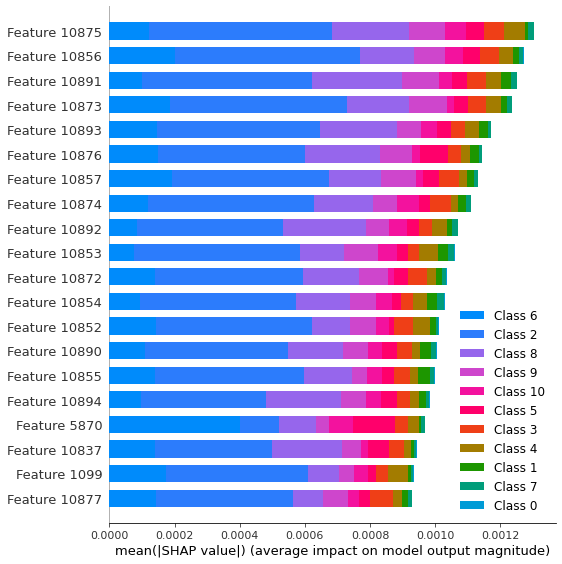

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_theta= createdataframeright("theta",4)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


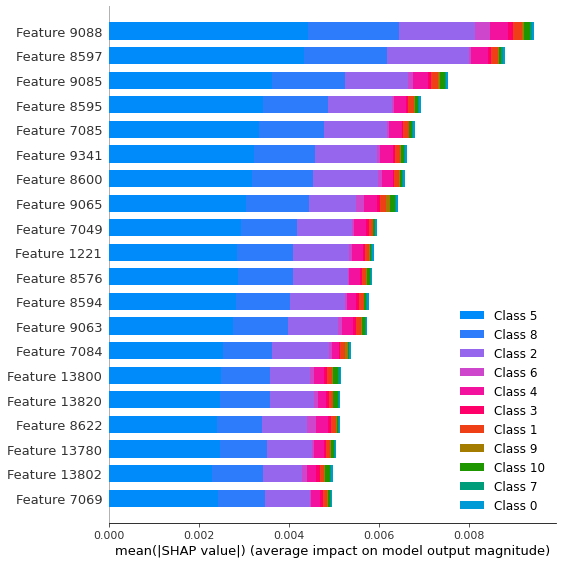

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_theta= createdataframeright("theta",5)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


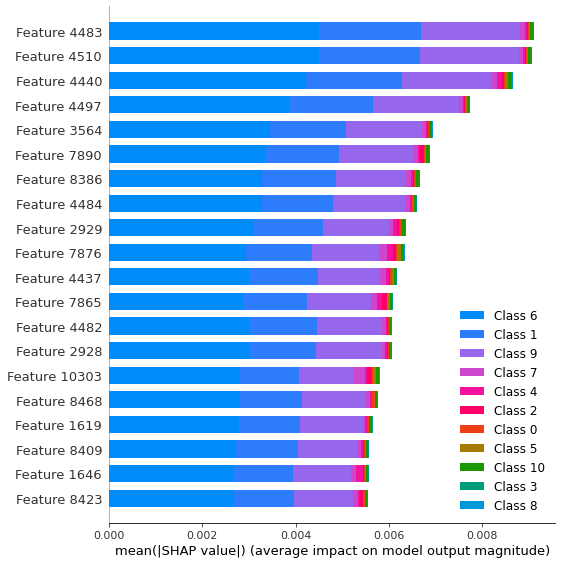

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_alpha= createdataframeleft("alpha",1)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


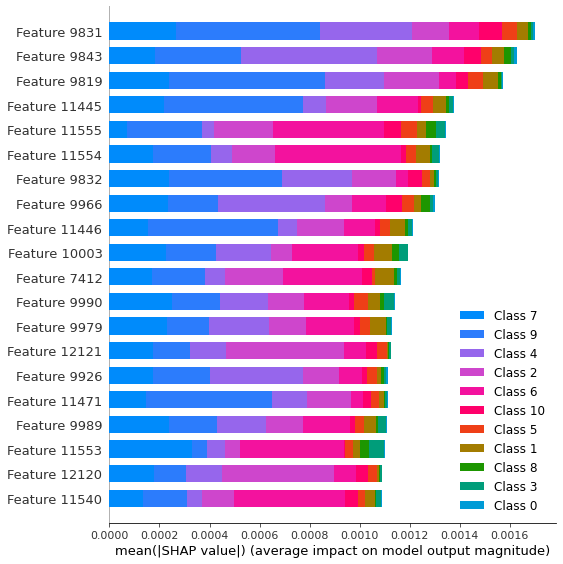

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_alpha= createdataframeleft("alpha",2)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


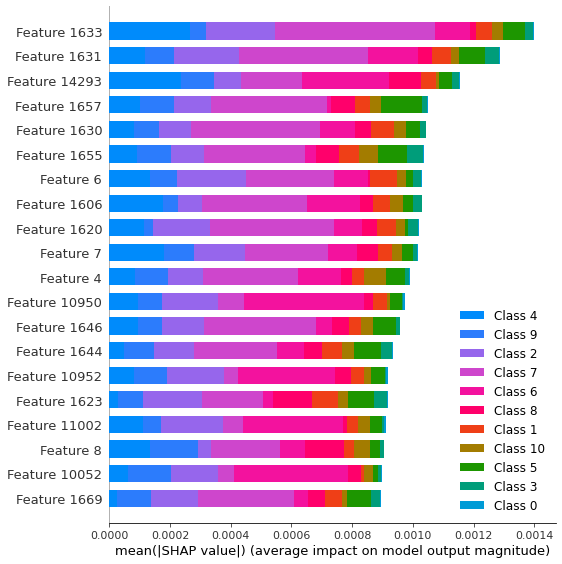

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      0.86      0.92         7
         8.0       0.00      0.00      0.00         0
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           0.97        32
   macro avg       0.89      0.87      0.88        32
weighted avg       1.00      0.97      0.98        32



Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.


In [ ]:
df_alpha= createdataframeleft("alpha",3)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


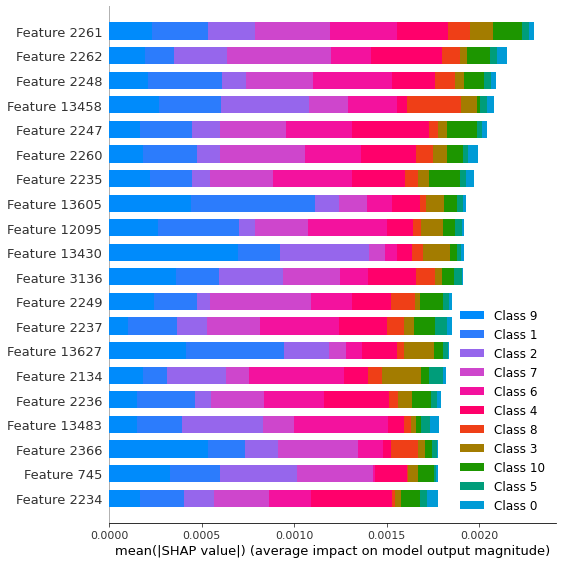

              precision    recall  f1-score   support

         1.0       0.75      1.00      0.86         3
         2.0       1.00      1.00      1.00         7
         3.0       0.00      0.00      0.00         0
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      0.86      0.92         7
         9.0       1.00      0.80      0.89         5
        10.0       1.00      1.00      1.00         2

    accuracy                           0.94        32
   macro avg       0.86      0.85      0.85        32
weighted avg       0.98      0.94      0.95        32



Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.


In [ ]:
df_alpha= createdataframeleft("alpha",4)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


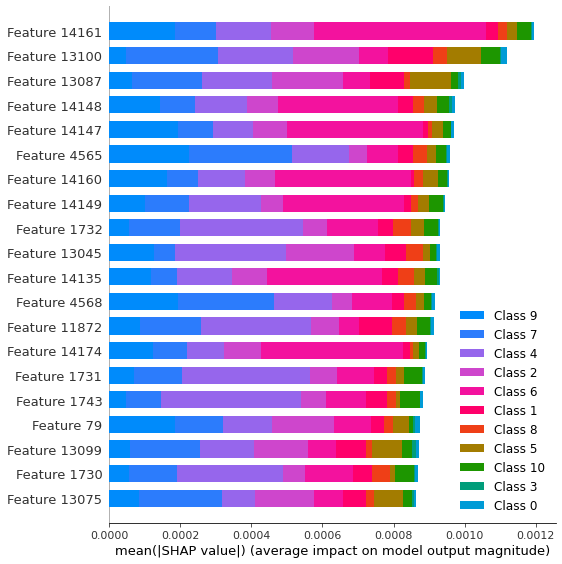

              precision    recall  f1-score   support

         1.0       0.75      1.00      0.86         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      0.86      0.92         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           0.97        32
   macro avg       0.97      0.98      0.97        32
weighted avg       0.98      0.97      0.97        32



In [ ]:
df_alpha= createdataframeleft("alpha",5)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


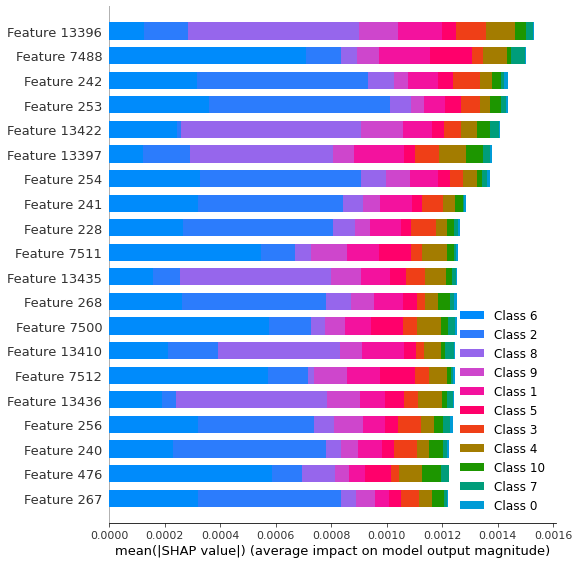

              precision    recall  f1-score   support

         1.0       0.67      1.00      0.80         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      0.67      0.80         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           0.97        30
   macro avg       0.97      0.97      0.96        30
weighted avg       0.98      0.97      0.97        30



In [ ]:
df_alpha= createdataframeright("alpha",1)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


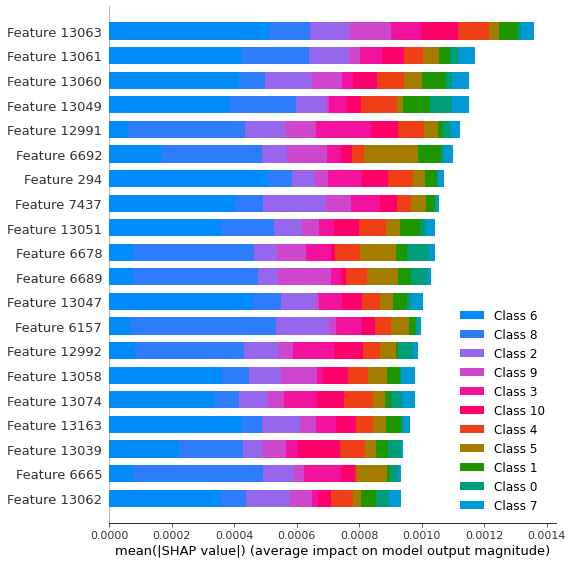

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_alpha= createdataframeright("alpha",2)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


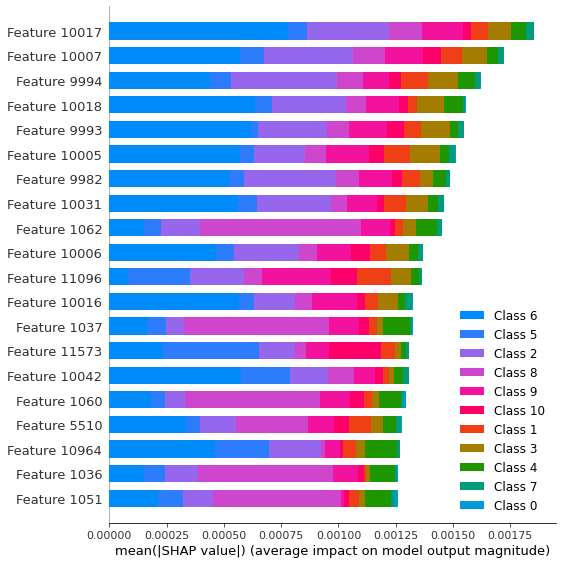

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_alpha= createdataframeright("alpha",3)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


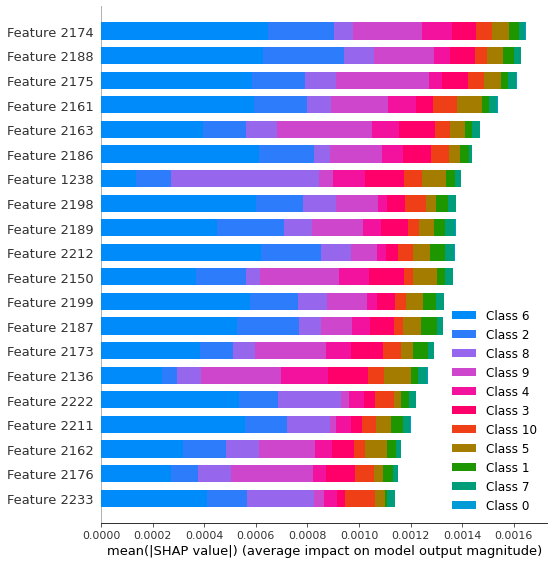

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_alpha= createdataframeright("alpha",4)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


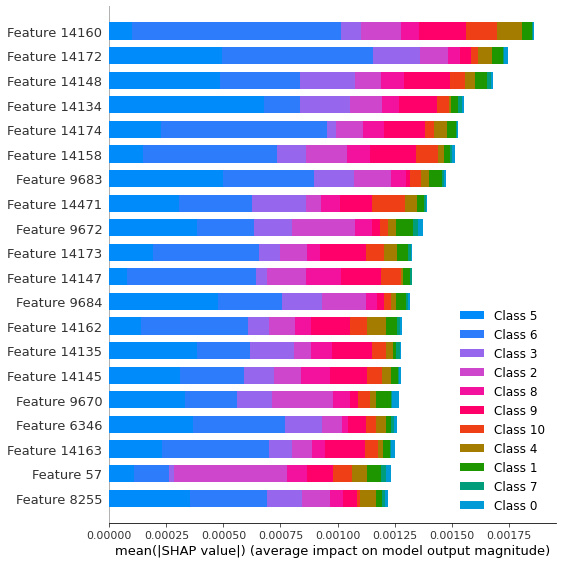

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       0.75      1.00      0.86         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      0.67      0.80         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           0.97        30
   macro avg       0.97      0.97      0.97        30
weighted avg       0.97      0.97      0.97        30



In [ ]:
df_alpha= createdataframeright("alpha",5)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


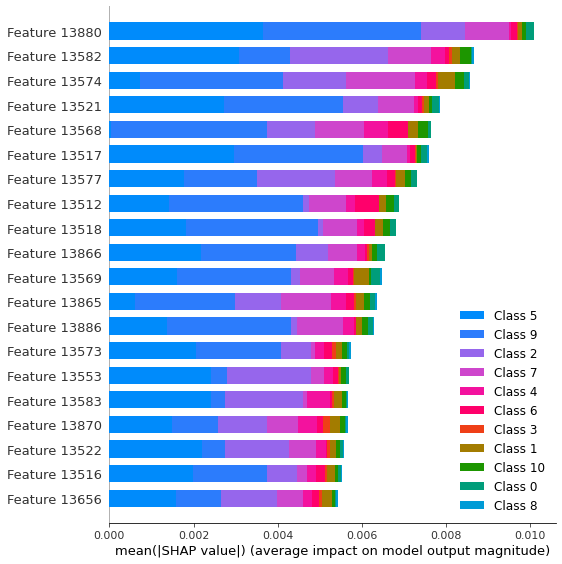

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      0.86      0.92         7
         4.0       1.00      1.00      1.00         3
         5.0       0.75      1.00      0.86         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           0.97        32
   macro avg       0.97      0.98      0.97        32
weighted avg       0.98      0.97      0.97        32



In [ ]:
df_beta= createdataframeleft("beta",1)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


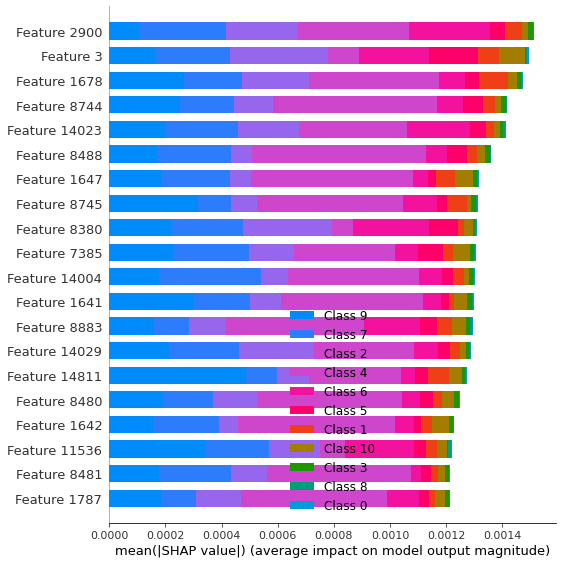

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_beta= createdataframeleft("beta",2)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


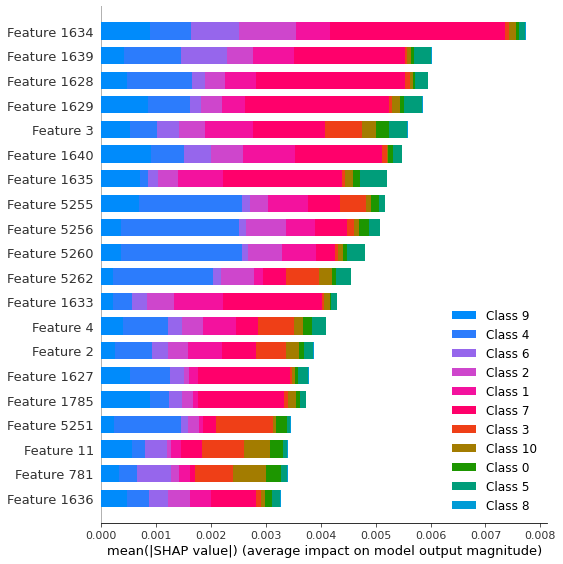

              precision    recall  f1-score   support

         1.0       0.75      1.00      0.86         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      0.86      0.92         7
         9.0       0.83      1.00      0.91         5
        10.0       1.00      0.50      0.67         2

    accuracy                           0.94        32
   macro avg       0.95      0.92      0.92        32
weighted avg       0.95      0.94      0.93        32



In [ ]:
df_beta= createdataframeleft("beta",3)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


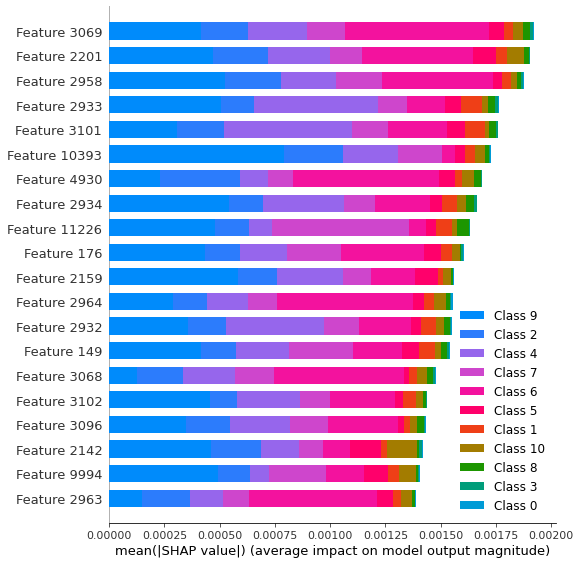

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       0.88      1.00      0.93         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      0.86      0.92         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           0.97        32
   macro avg       0.98      0.98      0.98        32
weighted avg       0.97      0.97      0.97        32



In [ ]:
df_beta= createdataframeleft("beta",4)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


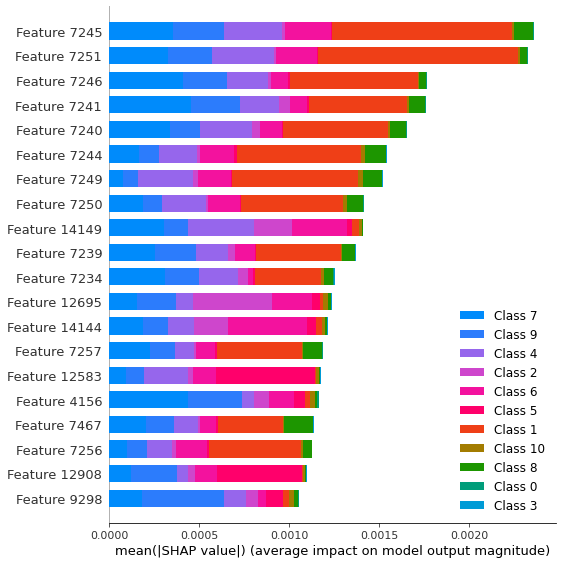

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_beta= createdataframeleft("beta",5)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


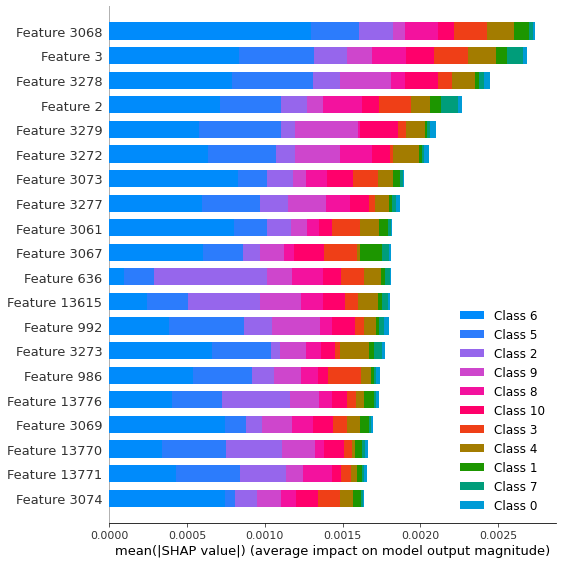

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_beta= createdataframeright("beta",1)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


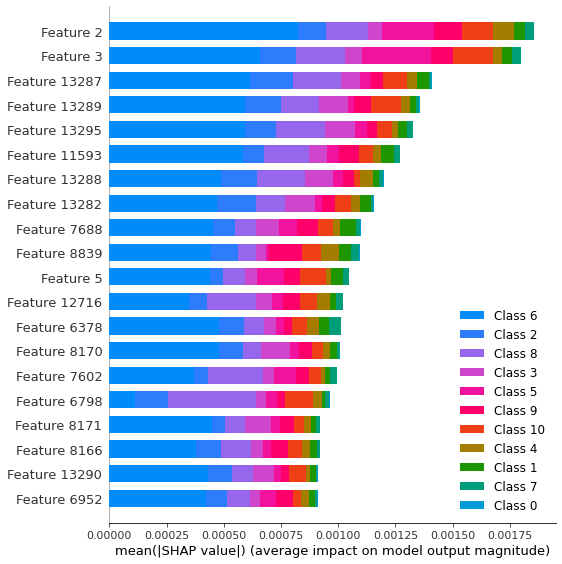

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_beta= createdataframeright("beta",2)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


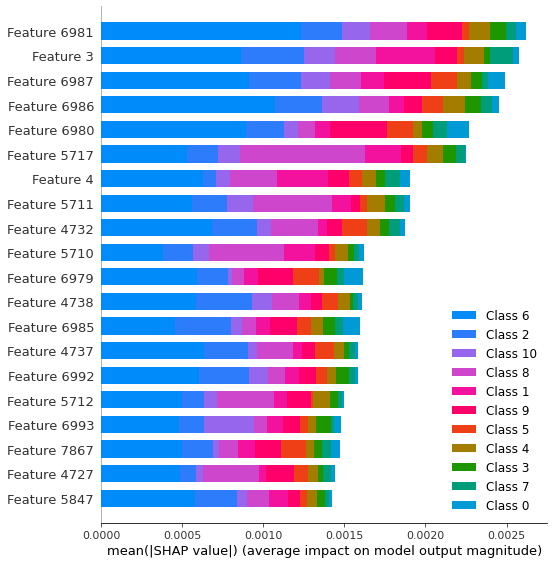

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



In [ ]:
df_beta= createdataframeright("beta",3)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


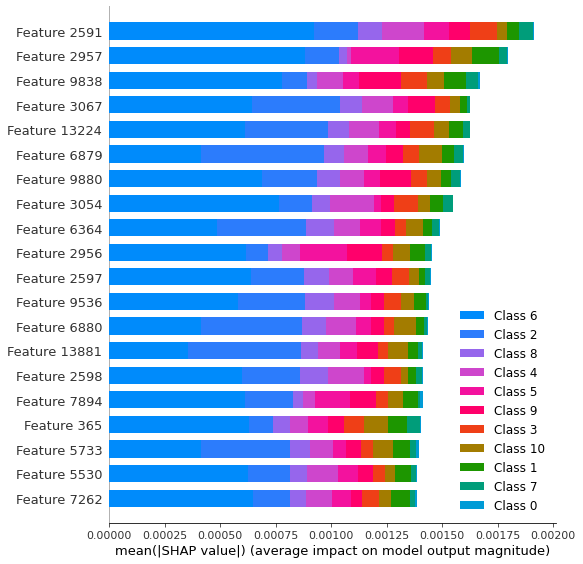

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       0.75      1.00      0.86         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      0.67      0.80         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           0.97        30
   macro avg       0.97      0.97      0.97        30
weighted avg       0.97      0.97      0.97        30



In [ ]:
df_beta= createdataframeright("beta",4)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


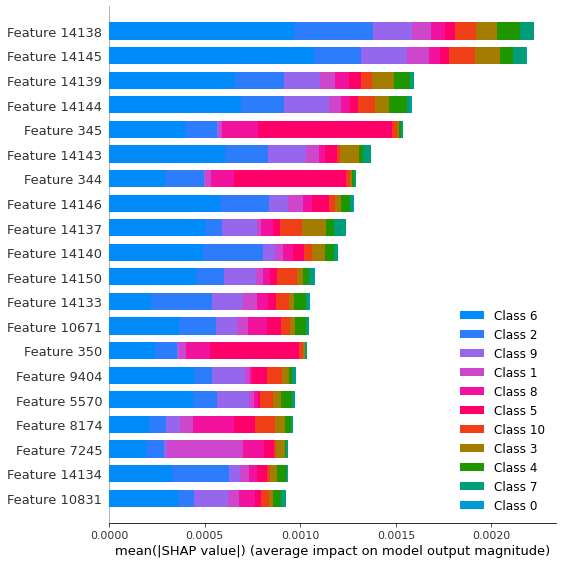

              precision    recall  f1-score   support

         1.0       0.67      1.00      0.80         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      0.67      0.80         3
         9.0       1.00      1.00      1.00         4
        10.0       1.00      1.00      1.00         3

    accuracy                           0.97        30
   macro avg       0.97      0.97      0.96        30
weighted avg       0.98      0.97      0.97        30



In [ ]:
df_beta= createdataframeright("beta",5)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


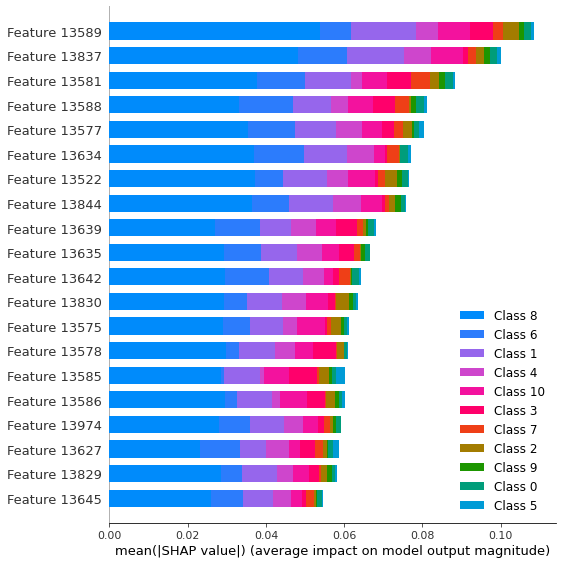

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       0.67      1.00      0.80         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      0.80      0.89         5
        10.0       1.00      1.00      1.00         2

    accuracy                           0.97        32
   macro avg       0.96      0.97      0.96        32
weighted avg       0.98      0.97      0.97        32



In [ ]:
df_gamma= createdataframeleft("gamma",1)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


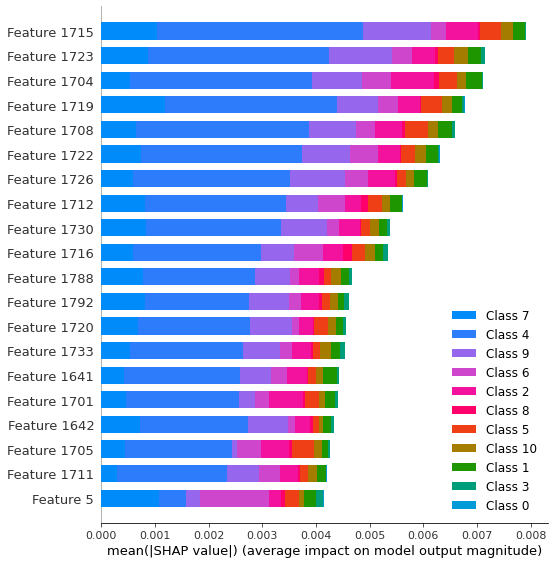

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_gamma= createdataframeleft("gamma",2)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


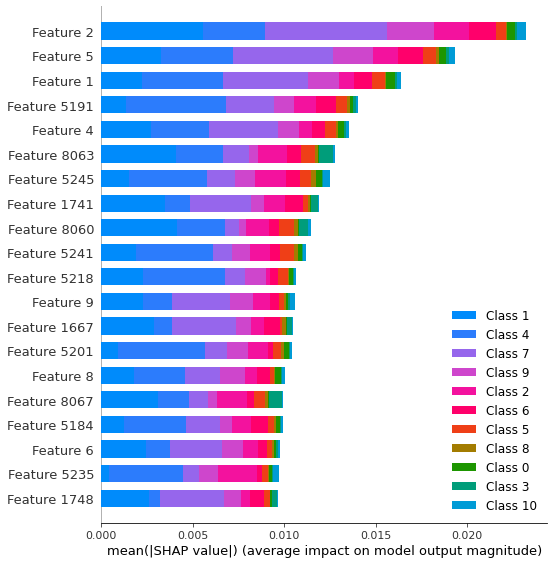

              precision    recall  f1-score   support

         1.0       0.75      1.00      0.86         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      0.86      0.92         7
         9.0       0.83      1.00      0.91         5
        10.0       1.00      0.50      0.67         2

    accuracy                           0.94        32
   macro avg       0.95      0.92      0.92        32
weighted avg       0.95      0.94      0.93        32



In [ ]:
df_gamma= createdataframeleft("gamma",3)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


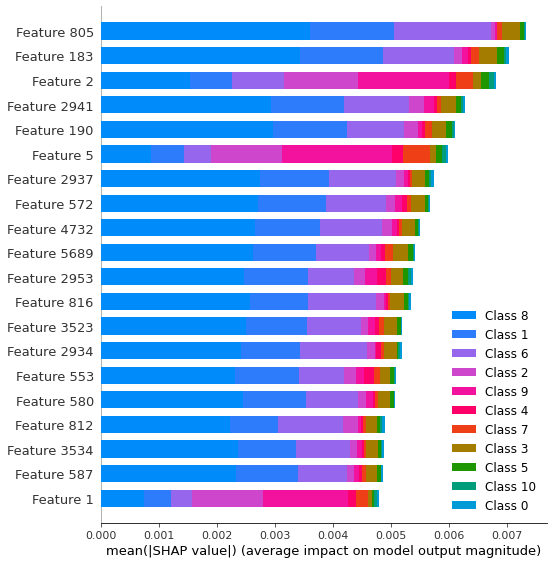

              precision    recall  f1-score   support

         1.0       0.75      1.00      0.86         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      0.71      0.83         7
         8.0       0.00      0.00      0.00         0
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           0.94        32
   macro avg       0.86      0.86      0.85        32
weighted avg       0.98      0.94      0.95        32



Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.


In [ ]:
df_gamma= createdataframeleft("gamma",4)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


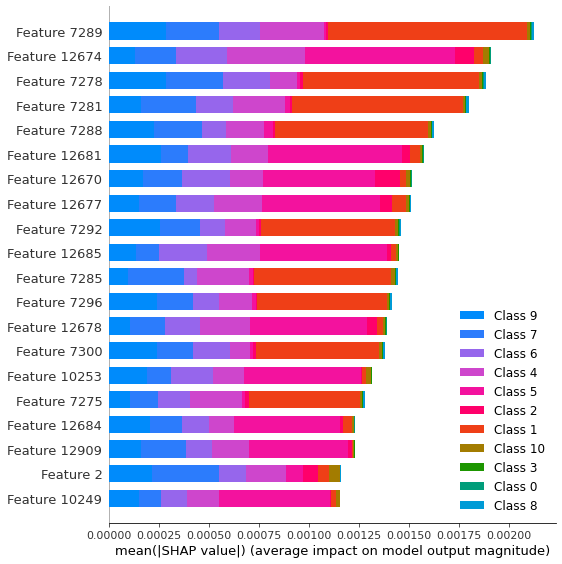

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         3
         2.0       1.00      1.00      1.00         7
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         3
         6.0       1.00      1.00      1.00         2
         7.0       1.00      1.00      1.00         7
         9.0       1.00      1.00      1.00         5
        10.0       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32



In [ ]:
df_gamma= createdataframeleft("gamma",5)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


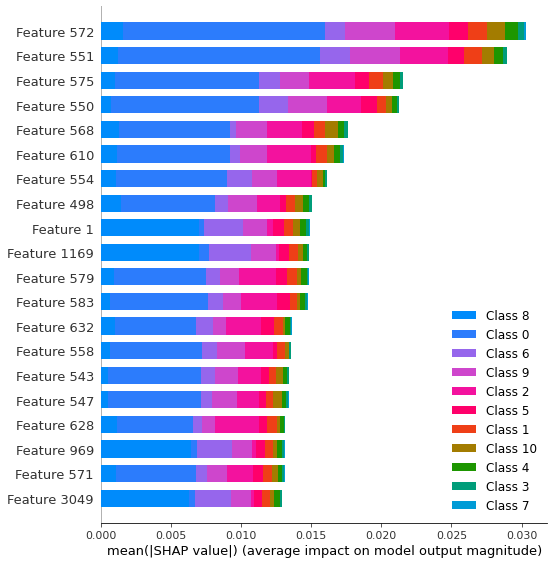

              precision    recall  f1-score   support

         1.0       1.00      0.50      0.67         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      0.75      0.86         4
         6.0       0.75      1.00      0.86         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      0.67      0.80         3
         9.0       0.80      1.00      0.89         4
        10.0       0.75      1.00      0.86         3

    accuracy                           0.90        30
   macro avg       0.93      0.89      0.89        30
weighted avg       0.92      0.90      0.90        30



In [ ]:
df_gamma= createdataframeright("gamma",1)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


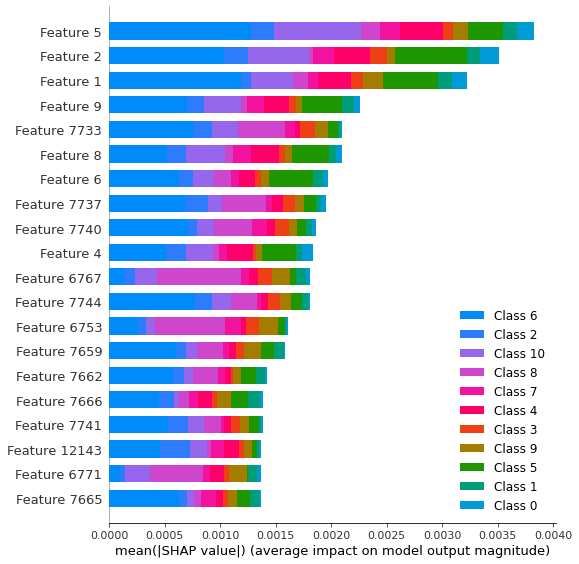

              precision    recall  f1-score   support

         1.0       1.00      0.50      0.67         2
         2.0       1.00      1.00      1.00         4
         3.0       0.75      1.00      0.86         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      0.75      0.86         4
        10.0       0.75      1.00      0.86         3

    accuracy                           0.93        30
   macro avg       0.95      0.93      0.92        30
weighted avg       0.95      0.93      0.93        30



In [ ]:
df_gamma= createdataframeright("gamma",2)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


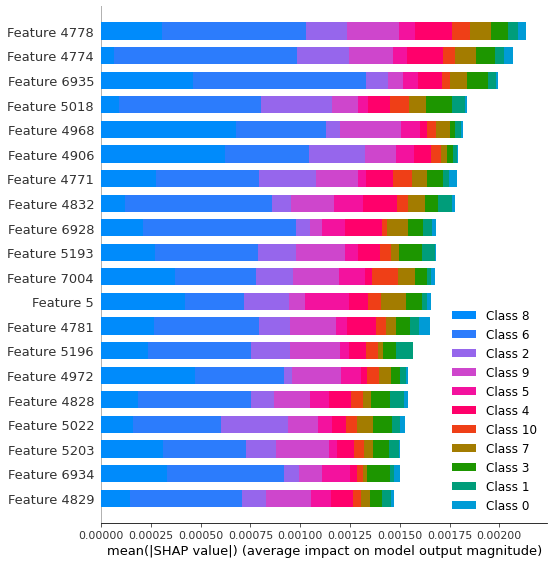

              precision    recall  f1-score   support

         1.0       1.00      0.50      0.67         2
         2.0       1.00      1.00      1.00         4
         3.0       1.00      1.00      1.00         3
         4.0       0.75      1.00      0.86         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      0.67      0.80         3
         7.0       0.50      1.00      0.67         1
         8.0       0.75      1.00      0.86         3
         9.0       1.00      0.75      0.86         4
        10.0       1.00      1.00      1.00         3

    accuracy                           0.90        30
   macro avg       0.90      0.89      0.87        30
weighted avg       0.93      0.90      0.90        30



In [ ]:
df_gamma= createdataframeright("gamma",3)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


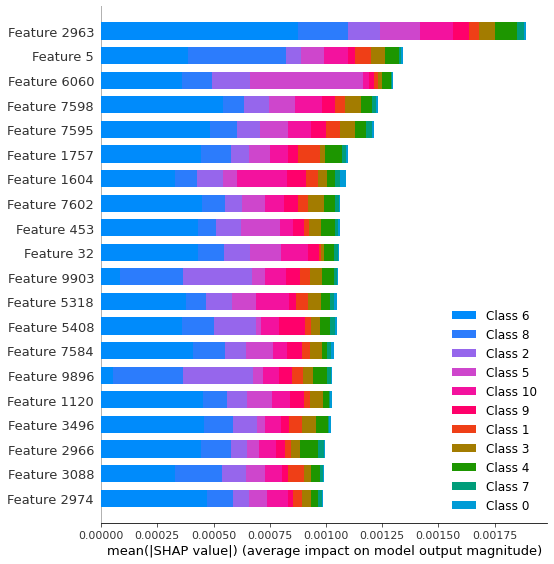

              precision    recall  f1-score   support

         1.0       1.00      1.00      1.00         2
         2.0       0.80      1.00      0.89         4
         3.0       1.00      1.00      1.00         3
         4.0       1.00      1.00      1.00         3
         5.0       1.00      1.00      1.00         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      1.00      1.00         3
         9.0       1.00      0.75      0.86         4
        10.0       1.00      1.00      1.00         3

    accuracy                           0.97        30
   macro avg       0.98      0.97      0.97        30
weighted avg       0.97      0.97      0.97        30



In [ ]:
df_gamma= createdataframeright("gamma",4)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode. See PR #1483 for discussion.


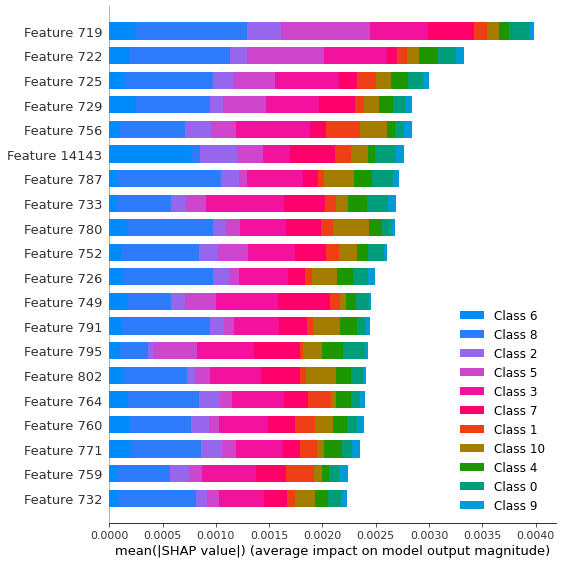

              precision    recall  f1-score   support

         1.0       1.00      0.50      0.67         2
         2.0       1.00      1.00      1.00         4
         3.0       0.75      1.00      0.86         3
         4.0       1.00      1.00      1.00         3
         5.0       0.80      1.00      0.89         4
         6.0       1.00      1.00      1.00         3
         7.0       1.00      1.00      1.00         1
         8.0       1.00      0.67      0.80         3
         9.0       1.00      0.75      0.86         4
        10.0       0.75      1.00      0.86         3

    accuracy                           0.90        30
   macro avg       0.93      0.89      0.89        30
weighted avg       0.92      0.90      0.90        30



In [ ]:
df_gamma= createdataframeright("gamma",5)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)